In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('../')

In [3]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm

import nibabel as nib
import SimpleITK as sitk
import napari

import plotly.express as px
import plotly.graph_objects as go

from scipy import ndimage
from scipy.ndimage import gaussian_filter
import open3d as o3d

from skimage.util import random_noise
from skimage import feature
from skimage import filters
from skimage import measure
from scipy.ndimage import affine_transform

from scipy.sparse import csr_matrix, linalg as sla

from registration.reg_utils import *
from registration.plot_utils import *
from registration.edge_utils import *

import open3d
import os
import gc
#from mayavi import mlab

import scipy
import pyamg

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [5]:
fixedImagePath = "../CCF_DATA/average_template_25.nii.gz"
movingImagePath = "../../registration/B39/brain_25.nii.gz"
axisAlignedDataPath = "../reg/axisAlignedData.nii.gz"

In [6]:
outputDir = "testresults"
if not os.path.isdir(outputDir):
    os.mkdir(outputDir) 

In [7]:
fdata, mdata = loadNiiImages([fixedImagePath, movingImagePath], scale=False)

# Axis Align

In [8]:
axisAlignedDataPath  = os.path.join(outputDir , "axisAlignedData.nii.gz")
A = getAlignAxisAffineMatrix(fdata, mdata)
alignedData = affine_transform(mdata,np.linalg.inv(A), output_shape = mdata.shape, order =1)
alignedData[alignedData<0] =0
create_nifti_image(alignedData, 2.5, axisAlignedDataPath, 1)

mdata = alignedData

100%|███████████████████████████████████████████████████████████████████████████████| 528/528 [00:02<00:00, 236.12it/s]


# Elastix Registration

In [13]:
elastixResult  = elastixRegistration(fixedImagePath , axisAlignedDataPath, outputDir, rescale= True, elastixDir="../elastix/")
elastixResult = elastixTransformation(axisAlignedDataPath, outputDir,elastixDir="../elastix/")

# Elastix 2D Refine - Abnormalities , 2D correspondences

In [14]:
edata = loadNiiImages([elastixResult])

In [16]:
edata.shape

(528, 320, 456)

In [26]:
imDir =r"C:\Users\3i\Desktop\reg"

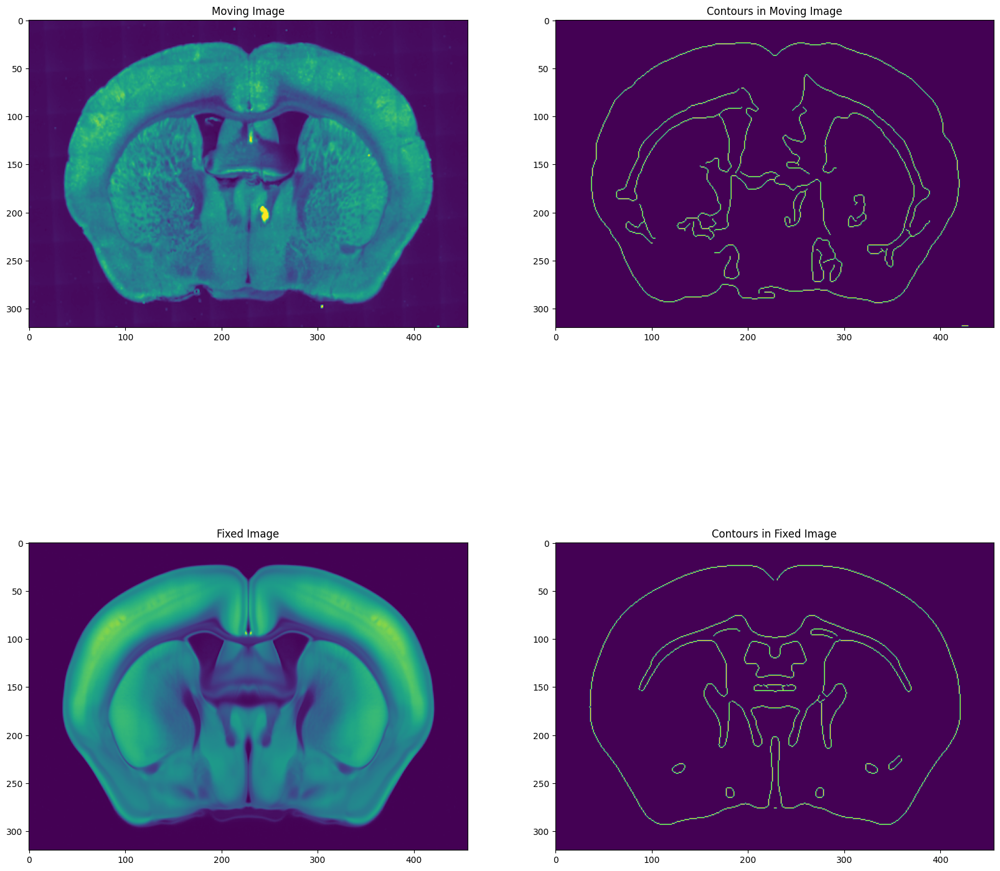

In [33]:
sno=225
fedge, medge = plot2DCorrespondences(fdata[sno], edata[sno], "Section {} 2D Correspondences".format(sno))

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 20), squeeze = False)

ax[0][0].imshow(edata[sno])
ax[0][0].set_title("Moving Image")
ax[0][1].imshow(medge)
ax[0][1].set_title("Contours in Moving Image")

ax[1][0].imshow(fdata[sno])
ax[1][0].set_title("Fixed Image")
ax[1][1].imshow(fedge)
ax[1][1].set_title("Contours in Fixed Image")
plt.savefig(os.path.join(imDir,"section{}.png".format(sno)))

In [34]:
movingImagePath = elastixResult
deformationField = sliceToSlice2DLaplacian(fixedImagePath , movingImagePath)
transformedData   = applyDeformationField(movingImagePath , deformationField)
create_nifti_image(transformedData, 2.5, os.path.join(outputDir, "elastix2DRefined.nii.gz"), 1/2)

100%|████████████████████████████████████████████████████████████████████████████████| 528/528 [26:19<00:00,  2.99s/it]


# Elastix 3D Refine - Best Results

In [35]:
movingImagePath = elastixResult
deformationField  = sliceToSlice3DLaplacian(fixedImagePath , movingImagePath , axis =0 )
transformedData   = applyDeformationField(movingImagePath , deformationField)
create_nifti_image(transformedData, 2.5, os.path.join(outputDir, "elastixRefined.nii.gz"), 1/2)

100%|████████████████████████████████████████████████████████████████████████████████| 528/528 [10:56<00:00,  1.24s/it]


Building data for Laplacian Sparse Matrix A
Creating Laplacian Sparse Matrix A
dx calculated in 255.6886487007141s
dz calculated in 384.0727710723877s


In [54]:
from skimage.color import gray2rgb, label2rgb
from skimage.segmentation import mark_boundaries, find_boundaries
import skimage
def convertToUint8(data):
    """
    Thresholds  and converts data to UINT8
    """
    maxVal  = np.percentile(data, 99)
    data[data > maxVal ] = maxVal
    data = data*255 /maxVal
    data = data.astype(np.uint8)
    
    return data

def drawContours(image, contours):
    if( len(np.squeeze(image).shape) ==2): 
        image  = gray2rgb (image)
    
    result_image = label2rgb(contours, image, alpha=0.5)
    return skimage.img_as_ubyte(result_image)

def getEdgeContours(image):
    """
    Applies Otsu Threshold and gets both outer and internal contours. 
    Filters by contour length
    """
    
    image[image>500]=500
    #data = skimage.exposure.equalize_adapthist(image.astype(np.uint16))*255
    local_thresh = skimage.filters.threshold_otsu(image)
    binary = image>local_thresh

    edges = feature.canny(binary, sigma=1)
    all_labels = measure.label(edges)
    
    for label in range(np.max(all_labels)):
        # Edge Length Paramenter should be automated
        if( np.sum(all_labels==label)<100):
            edges[all_labels==label] = 0

    edges = skimage.morphology.thin(edges)
    return edges, binary

def getAnnContours(image):
    """
    Applies Otsu Threshold and gets both outer and internal contours. 
    Filters by contour length
    """
    image[image<1] =0
    edges = feature.canny(image, sigma=1)
    all_labels = measure.label(edges)
    
    for label in range(np.max(all_labels)):
        # Edge Length Paramenter should be automated
        if( np.sum(all_labels==label)<100):
            edges[all_labels==label] = 0

    edges = skimage.morphology.thin(edges)
    return edges


def labelWithAnnotation(data, annotation):
    e = find_boundaries(annotation)
    contouredImage = drawContours(data, e)
    return contouredImage
    
def getTestSamples(data, template= None, n=8,  testSamples=[],axis =0 , saveprefix="",):
    """
    Draws Contours extracted from moving onto fixed samples
    """
    assert n>1
    if type(data) == str:
        dataImage = nib.load(data)
        data = dataImage.get_fdata()
    data[data<0] =0
    data = convertToUint8(data)
    labelled_samples =[] 
    if len(testSamples)==0:
        testSamples = np.arange(0, data.shape[0], data.shape[0]/n)[1:]
        testSamples = testSamples.astype(int)
    if template is None:
        for testSample in testSamples:
            labelled_samples.append(data[testSample] )
            if saveprefix != "":
                skimage.io.imsave("tests/{}_{}.jpg".format(saveprefix, testSample),data[testSample] )
        return labelled_samples
    if type(template) == str:
        templateImage = nib.load(template)
        template = templateImage.get_fdata()
        template = convertToUint8(template)
    labelled_samples =[]    
    for testSample in testSamples:
        contouredImage  = labelWithAnnotation(np.take(data, testSample, axis=axis),np.take(template, testSample, axis=axis))
        labelled_samples.append(contouredImage)
        
        if saveprefix != "":
            skimage.io.imsave("tests/{}_{}.jpg".format(saveprefix, testSample),contouredImage )
    return labelled_samples

In [45]:
annotationImagePath = "../CCF_DATA/annotation_25.nii.gz"
annotationImage = nib.load(annotationImagePath)
annData = annotationImage.get_fdata()

In [ ]:
imDir =r"C:\Users\3i\Desktop\reg"

In [62]:
axis0testSamples = np.arange(0, annData.shape[0], annData.shape[0]/8)[1:]
axis0testSamples = axis0testSamples.astype(int)

axis1testSamples = [133,145]

In [55]:
elastixBasicPath= "testresults/elastixBasic.nii"
basicSamples_0 = getTestSamples(elastixBasicPath, annData, testSamples = axis0testSamples)
basicSamples_1 = getTestSamples(elastixBasicPath, annData , axis =1 , testSamples=axis1testSamples)

In [63]:
basicSampleDir = os.path.join(imDir, "basic")
if not os.path.isdir(basicSampleDir):
    os.mkdir(basicSampleDir)
for i, sample in enumerate(basicSamples_0):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis0_{}.jpg".format( axis0testSamples[i])),basicSamples_0[i] )
    
for i, sample in enumerate(basicSamples_1):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis1_{}.jpg".format( axis1testSamples[i])),basicSamples_1[i] )

In [59]:
elastixAxisAlignedPath= elastixResult
rescaledSamples_0 = getTestSamples(elastixAxisAlignedPath, annData , testSamples = axis0testSamples)
rescaledSamples_1 = getTestSamples(elastixAxisAlignedPath, annData , axis =1 , testSamples=axis1testSamples)

In [64]:
basicSampleDir = os.path.join(imDir, "aligned")
if not os.path.isdir(basicSampleDir):
    os.mkdir(basicSampleDir)
for i, sample in enumerate(basicSamples_0):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis0_{}.jpg".format( axis0testSamples[i])),rescaledSamples_0[i] )
    
for i, sample in enumerate(basicSamples_1):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis1_{}.jpg".format( axis1testSamples[i])),rescaledSamples_1[i] )

In [60]:
elastixRefinedPath= os.path.join(outputDir, "elastixRefined.nii.gz")
refinedSamples_0 = getTestSamples(elastixRefinedPath, annData,testSamples = axis0testSamples )
refinedSamples_1 = getTestSamples(elastixRefinedPath, annData , axis =1 , testSamples=axis1testSamples)

In [65]:
basicSampleDir = os.path.join(imDir, "refined")
if not os.path.isdir(basicSampleDir):
    os.mkdir(basicSampleDir)
for i, sample in enumerate(basicSamples_0):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis0_{}.jpg".format( axis0testSamples[i])),refinedSamples_0[i] )
    
for i, sample in enumerate(basicSamples_1):
    skimage.io.imsave(os.path.join(basicSampleDir, "axis1_{}.jpg".format( axis1testSamples[i])),refinedSamples_1[i] )

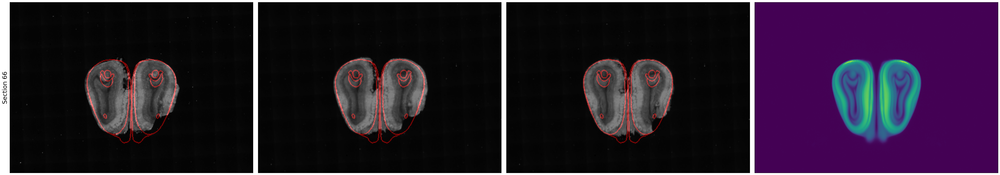

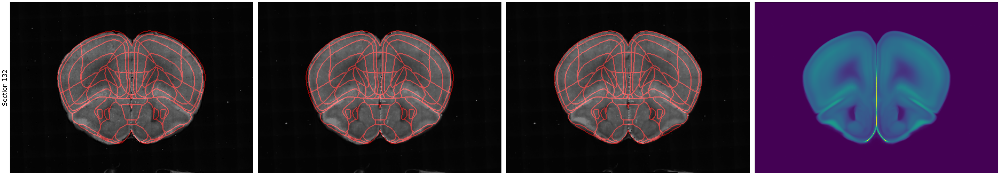

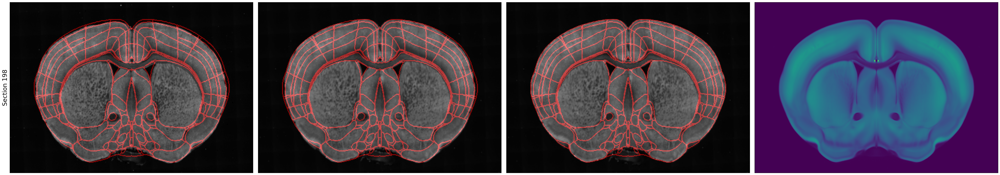

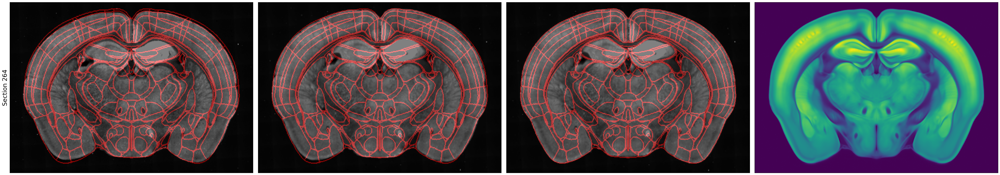

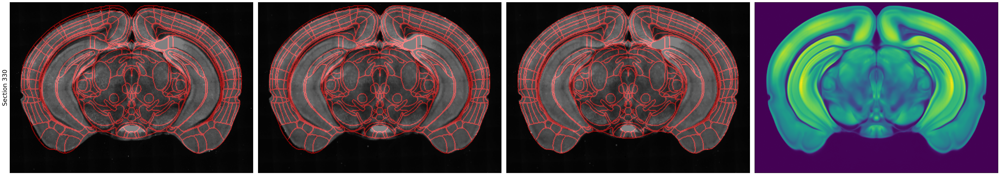

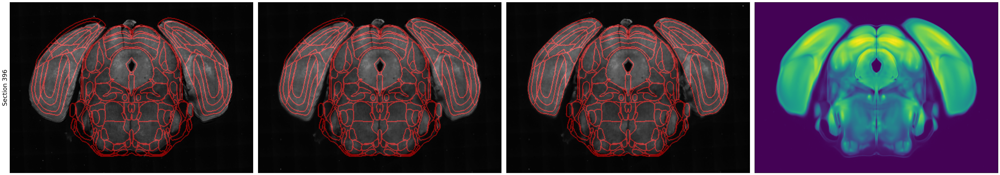

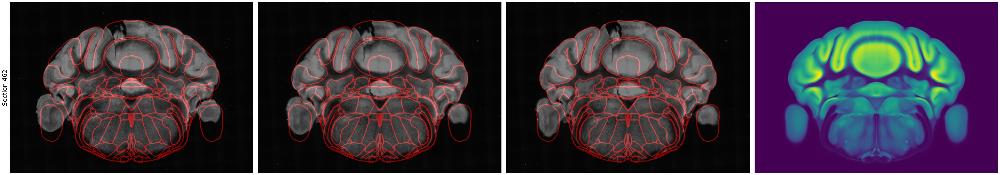

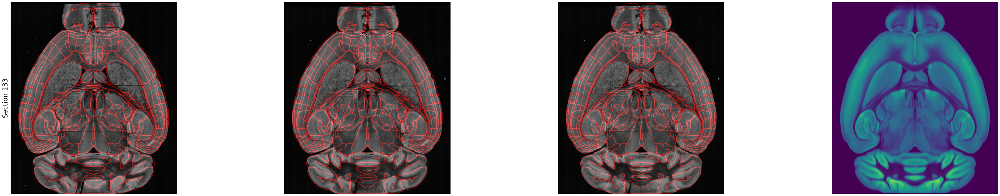

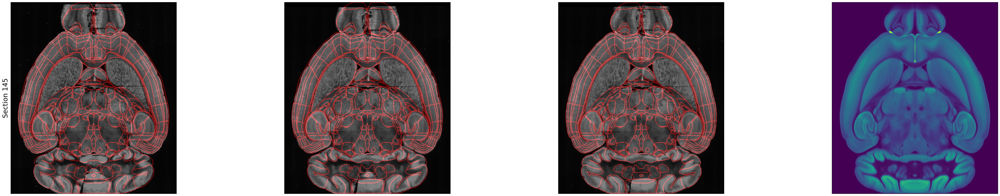

In [84]:
combinedDir = os.path.join(imDir, "combined")
if not os.path.isdir(combinedDir):
    os.mkdir(combinedDir)
for i,sno in enumerate(axis0testSamples):
    fig, ax = plt.subplots(1,4, figsize=(45, 8), squeeze = False,  constrained_layout=True)
    ax[0][0].imshow(basicSamples_0[i])
    ax[0][1].imshow(rescaledSamples_0[i])
    ax[0][2].imshow(refinedSamples_0[i])
    ax[0][3].imshow(np.take(fdata, sno, axis=0))
    for ax in fig.axes:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_aspect('equal')
    fig.axes[0].set_ylabel("Section {}".format(sno), fontsize=20)
    plt.savefig(os.path.join(combinedDir, "combined0_{}.jpg".format(sno)))
    
for i,sno in enumerate(axis1testSamples):
    fig, ax = plt.subplots(1,4, figsize=(45, 8), squeeze = False,  constrained_layout=True)
    ax[0][0].imshow(basicSamples_1[i])
    ax[0][1].imshow(rescaledSamples_1[i])
    ax[0][2].imshow(refinedSamples_1[i])
    ax[0][3].imshow(np.take(fdata, sno, axis=1))
    for ax in fig.axes:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_aspect('equal')
    fig.axes[0].set_ylabel("Section {}".format(sno), fontsize=20)
    plt.savefig(os.path.join(combinedDir, "combined1_{}.jpg".format(sno)))

# Scaling, Translation, ICP

In [36]:
nx, ny, nz  = fdata.shape
nd  = len(fdata.shape)
spacing = 100
fthresh = 5
mthresh =75
rd = RegistrationData(fdata, mdata, spacing, fthresh, mthresh)
mpoints = rd.mpoints.copy()
fpoints = rd.fpoints.copy()

S = getScaleMatrix(rd.fbinary, rd.mbinary)
mpoints= affineTransformPointCloud(rd.mpoints,S)
T = getCenterTranslationMatrix(fpoints, mpoints)
mpoints= affineTransformPointCloud(rd.mpoints,T@S)
R = align_principle_axes(fpoints, mpoints)
R = np.eye(4)
A1 = R@T@S
#mpoints = affineTransformPointCloud(rd.mpoints,A1)
rd.set_mpoints(mpoints)
rd.estimate_fnormals()
rd.estimate_mnormals()
A2 = icp_registration(rd)

A= A2@A1
A[3] = [0,0,0,1]
rd.applyAffineTransform(A)

448779it [01:04, 6920.38it/s]
210331it [00:20, 10483.26it/s]
 48%|███████████████████████████████████████▎                                          | 12/25 [01:03<01:08,  5.25s/it]
446395it [01:03, 6983.84it/s]


# Keyframe 3D - Keyframe mapping graph

In [39]:
fkeys, mkeys = calculateKeyPoints(rd.fbinary, rd.mbinary)
n = rd.fdata.shape[0]
valuesx = np.zeros(n)
valuesx[fkeys]=mkeys-fkeys
A = laplacianA1D(n, fkeys)
dx = lgmres(A, valuesx)[0]

msno =[]
for sno in range(rd.fdata.shape[0]):
    tsno = int(sno + dx[sno])
    if(tsno<0):
        tsno=0
    if(tsno>=n):
        tsno = n-1
    msno.append(tsno)
    

Building data for Laplacian Sparse Matrix A
Creating Laplacian Sparse Matrix A


C:\Users\3i\AppData\Local\Temp\ipykernel_8252\3846944066.py:6: DeprecationWarning:

scipy.sparse.linalg.lgmres called without specifying `atol`. The default value will change in the future. To preserve current behavior, set ``atol=tol``.



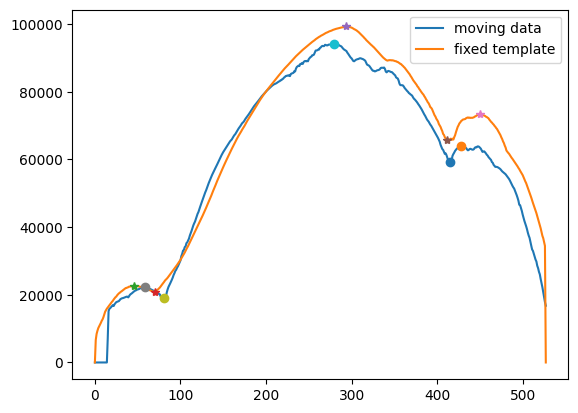

In [41]:
msno =[]
marea=[]
farea =[]
for sno in range(rd.fdata.shape[0]):
    farea.append(len(rd.fbinary[sno].nonzero()[0]))
for sno in range(rd.mdata.shape[0]):
    marea.append(len(rd.mbinary[sno].nonzero()[0]))
    
plt.plot(marea, label = "moving data")
plt.plot(farea, label = "fixed template")

for f in fkeys:
    plt.plot(f,farea[f], '*' )
for m in mkeys:
    plt.plot(m,marea[m], 'o' )

plt.legend()

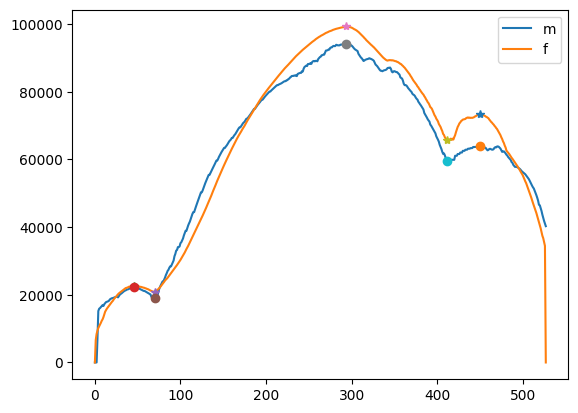

In [42]:
msno =[]
marea=[]
farea =[] 
n = rd.fdata.shape[0]
for sno in range(n):
    tsno = int(sno + dx[sno])
    if(tsno<0):
        tsno=0
    if(tsno>=n):
        tsno = n-1
    msno.append(tsno)
    marea.append(len(rd.mbinary[tsno].nonzero()[0]))
    farea.append(len(rd.fbinary[sno].nonzero()[0]))
    
plt.plot(marea, label="moving data")
plt.plot(farea, label = "fixed template")
for f in fkeys:
    plt.plot(f,farea[f], '*' )
    m = int(f + dx[f])
    plt.plot(f,marea[f], 'o' )
plt.legend()

In [ ]:
sno=255
plot2DCorrespondences(sno, rd.fdata[sno], rd.mdata[msno[sno]])

# 3D-3D Registration

In [13]:
from registration.laplacian3DRegistration import *

In [16]:
deformationField = np.zeros((nd, nx, ny, nz))

dx, dy,dz = nonLinearRegistration(rd , tol =1e-2)

deformationField[0] = dx
deformationField[1] = dy
deformationField[2] = dz
transformedData   = applyDeformationField(rd.mdata , deformationField)

27652it [00:02, 12609.21it/s]


Building data for Laplacian Sparse Matrix A
Creating Laplacian Sparse Matrix A
dx calculated in 12.113000392913818s
dy calculated in 24.56403422355652s
dz calculated in 36.79703378677368s


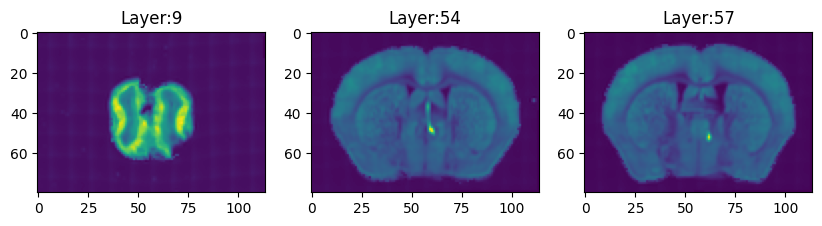

In [17]:
plot_samples(transformedData)